# Import modules

In [1]:
import numpy as np
import numpy.random as random
import pandas as pd
import scanpy as sc
import seaborn as sns
import matplotlib.pyplot as plt
import scanpy.external as sce
import anndata

In [2]:
import session_info
session_info.show()

In [3]:
sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.settings.set_figure_params(dpi=300, color_map='RdPu')

# Read in data

In [4]:
adata = sc.read_h5ad('/home/jovyan/mount/gdrive/Colab/data/scVI/RNA_adult_full_raw_SAN-aCM_post-scVI.h5ad')
adata

AnnData object with n_obs × n_vars = 9857 × 26710
    obs: 'sangerID', 'combinedID', 'donor', 'donor_type', 'region', 'region_finest', 'age', 'gender', 'facility', 'cell_or_nuclei', 'modality', 'kit_10x', 'flushed', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'scrublet_score', 'scrublet_leiden', 'cluster_scrublet_score', 'doublet_pval', 'doublet_bh_pval', 'batch_key', 'leiden_scVI', 'cell_type', 'cell_state_HCAv1', 'cell_state_scNym', 'cell_state_scNym_confidence', 'cell_state', 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'n_counts', '_scvi_batch', '_scvi_labels', 'clus20', 'doublet_cls', 'original_or_new', 'batch', 'scANVI_predictions'
    var: 'gene_name-new', 'gene_name_scRNA-0-original', 'gene_name_snRNA-1-original', 'gene_name_multiome-2-original', 'n_cells'
    uns: '_scvi_manager_uuid', '_scvi_uuid'
    obsm: 'X_scArches', 'X_scVI', '_scvi_extra_continuous_covs'

In [5]:
adata.obs['batch_key'].value_counts()

A61_Nuclei_Multiome-v1     3841
AH1_Nuclei_Multiome-v1     2220
AV14_Nuclei_Multiome-v1    1420
AH2_Nuclei_Multiome-v1     1058
AV3_Nuclei_Multiome-v1      851
AV10_Nuclei_Multiome-v1     412
AV13_Nuclei_Multiome-v1      55
Name: batch_key, dtype: int64

# Clustering, UMAP

In [23]:
sc.pp.neighbors(adata, use_rep="X_scVI", n_neighbors=15)
sc.tl.umap(adata, min_dist=0.05, spread=0.5, n_components=3)

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:01)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:16)


In [24]:
sc.tl.leiden(adata, resolution=1, key_added='leiden_scVI')

running Leiden clustering
    finished: found 20 clusters and added
    'leiden_scVI', the cluster labels (adata.obs, categorical) (0:00:01)


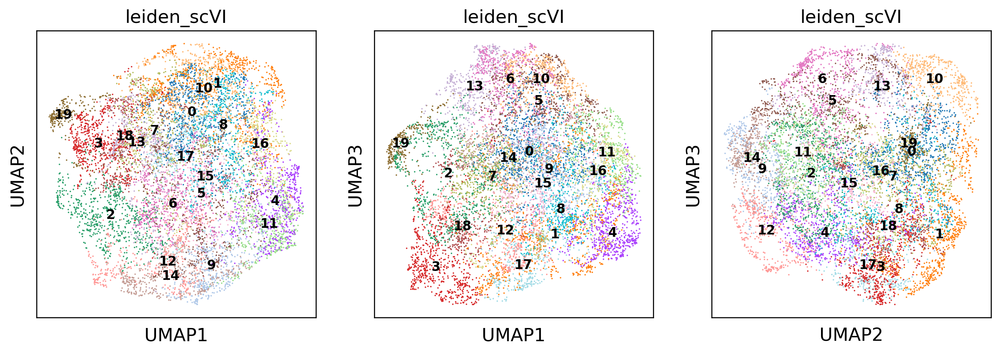

In [33]:
sc.pl.umap(adata, color=['leiden_scVI'], size=5, wspace=0.1, legend_loc='on data', legend_fontsize=10,components='all')

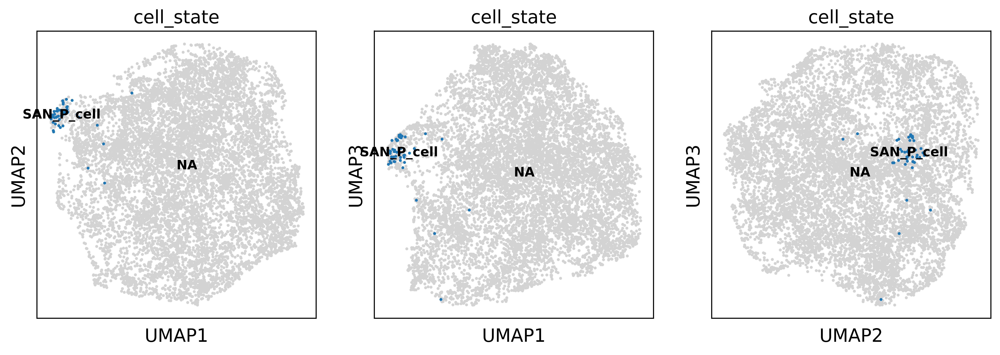

In [26]:
sc.pl.umap(adata, color=['cell_state'], groups=['SAN_P_cell'], size=20, wspace=0.1, legend_loc='on data', legend_fontsize=10,components='all')

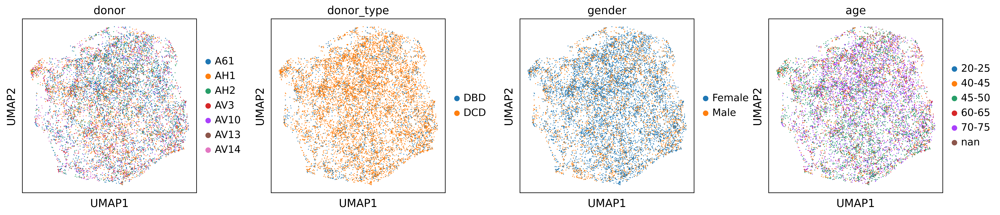

In [15]:
sc.pl.umap(adata, color=['donor','donor_type','gender','age'], size=5, wspace=0.3)

# Marker expressions

In [12]:
## set gene name as var_names 
adata.var['gene_id']=adata.var_names.copy()
adata.var.set_index('gene_name-new',inplace=True)
adata.var_names=adata.var_names.astype('str')
adata.var_names_make_unique()

## filter and lognormalised
sc.pp.filter_genes(adata, min_cells=3)
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)

KeyError: "None of ['gene_name-new'] are in the columns"

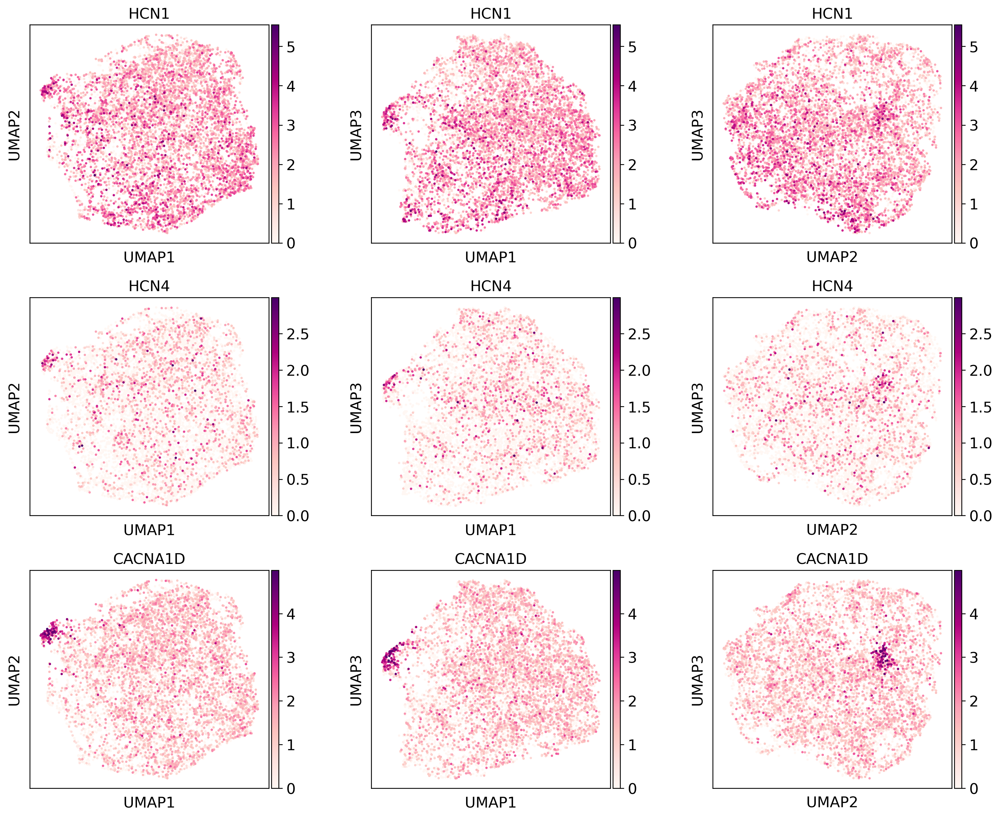

In [29]:
sc.pl.umap(adata, color=['HCN1','HCN4','CACNA1D'], size=20, wspace=0.3, components='all',ncols=3)

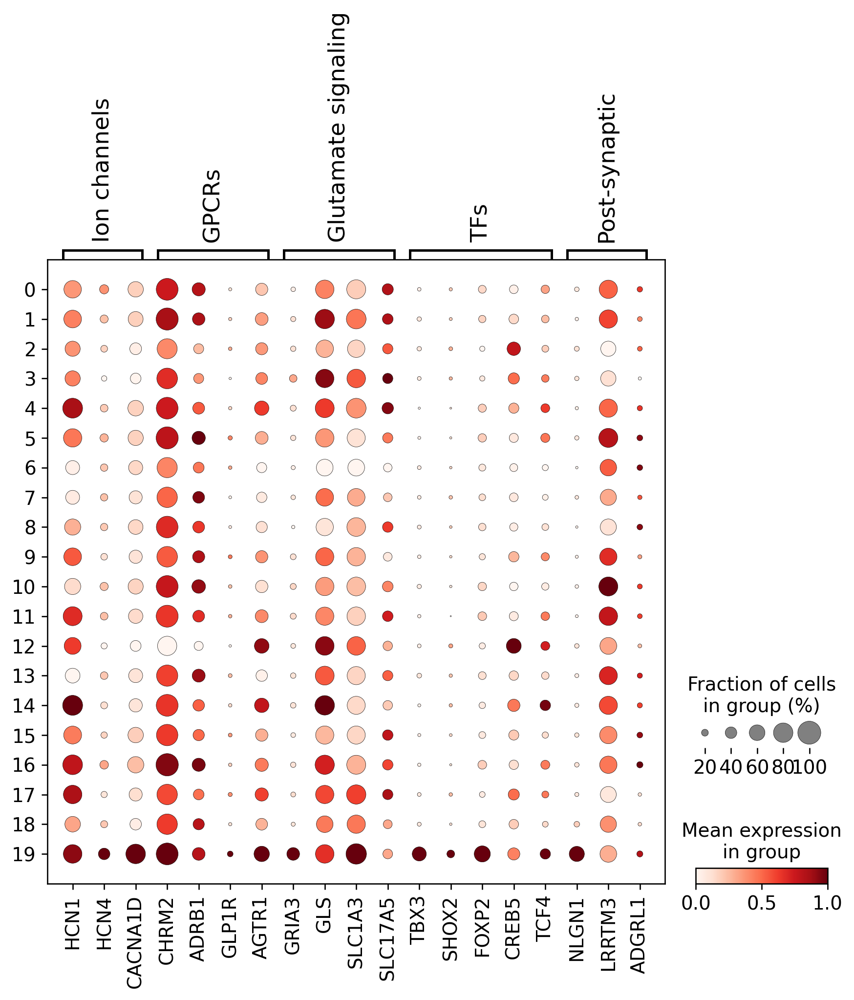

In [30]:
sc.settings.set_figure_params(dpi=120, color_map='RdPu')

markers={
    'Ion channels':['HCN1','HCN4','CACNA1D',], 
    # 'AV bundle cell':['GJA5','CRNDE','CNTN5'],
    'GPCRs':['CHRM2','ADRB1','GLP1R','AGTR1'],
    'Glutamate signaling':['GRIA3','GLS','SLC1A3','SLC17A5'],
    'TFs':['TBX3','SHOX2','FOXP2','CREB5','TCF4'],
    'Post-synaptic':['NLGN1','LRRTM3','ADGRL1']
}

# cell adhesion protein on the postsynaptic membrane
for k,v in markers.items():
    markers[k]=[x for x in v if x in adata.var_names]

sc.pl.dotplot(adata, 
              markers, 
              groupby='leiden_scVI',
              dendrogram=False,
             # use_raw=True,
              standard_scale="var",
              color_map="Reds",
             swap_axes=False,
             # title='Neurexin receptors'
             )

# Annotate CCS cells

In [31]:
Pcell_clluster = '19'

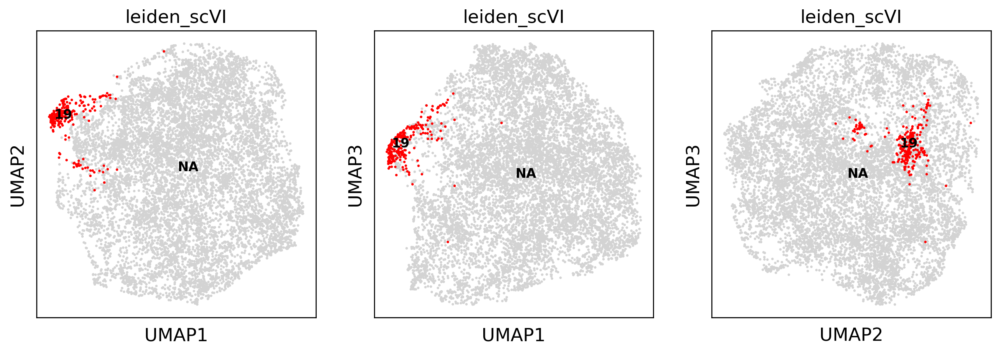

In [34]:
adata.uns["leiden_scVI_colors"][list(adata.obs['leiden_scVI'].cat.categories).index(Pcell_clluster)]='red'
sc.pl.umap(adata, color=['leiden_scVI'], groups=Pcell_clluster, size=15, wspace=0.1, legend_loc='on data', legend_fontsize=10,components='all')

/home/jovyan/my-conda-envs/cellpymc/lib/python3.7/site-packages/ipykernel_launcher.py:8: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  


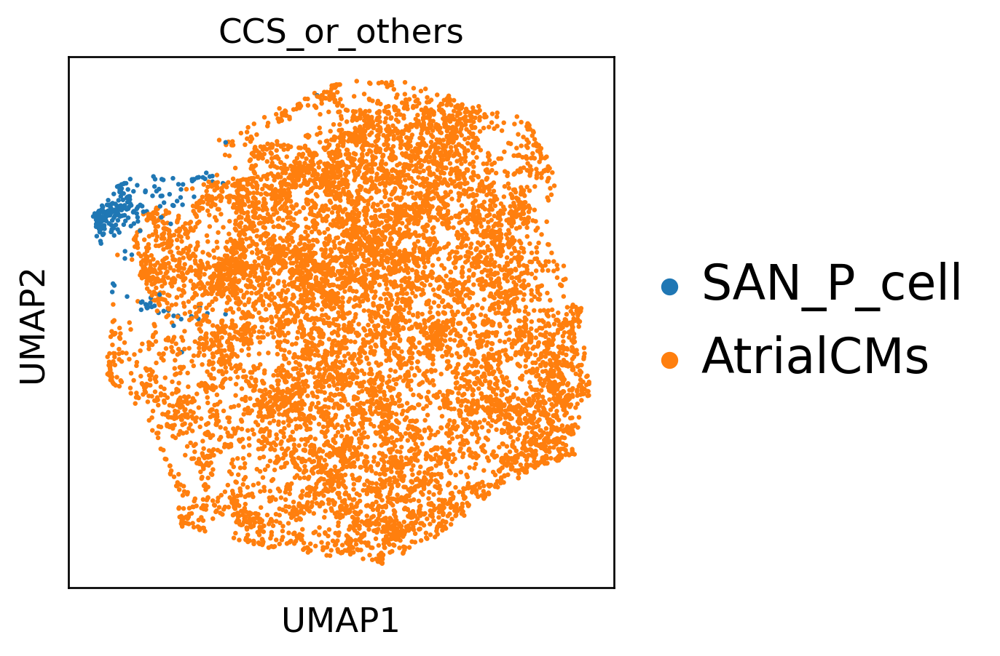

In [35]:
adata.obs['CCS_or_others'] = 'AtrialCMs'
adata.obs.loc[adata.obs_names[adata.obs['leiden_scVI']==Pcell_clluster],'CCS_or_others'] = 'SAN_P_cell'

adata.obs['CCS_or_others']=adata.obs['CCS_or_others'].astype('category')
adata.obs['CCS_or_others'].cat.reorder_categories([
   'SAN_P_cell',
    'AtrialCMs'
     ], inplace=True)

sc.pl.umap(adata, color=['CCS_or_others'], size=15, wspace=0.5, legend_fontsize=20)

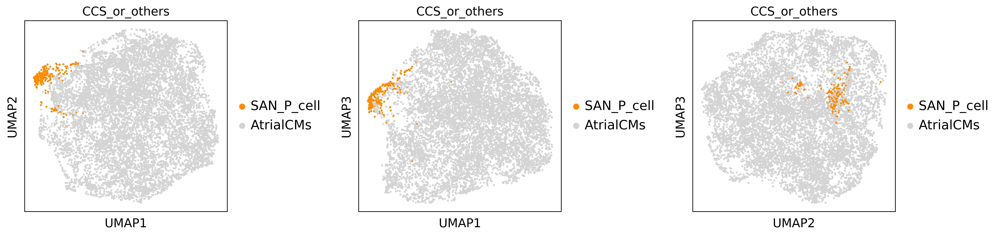

In [9]:
adata.uns["CCS_or_others_colors"][list(adata.obs['CCS_or_others'].cat.categories).index('SAN_P_cell')]='darkorange'
adata.uns["CCS_or_others_colors"][list(adata.obs['CCS_or_others'].cat.categories).index('AtrialCMs')]='lightgrey'

sc.pl.umap(adata, color=['CCS_or_others'], size=20, wspace=0.5, legend_fontsize=15, components='all')

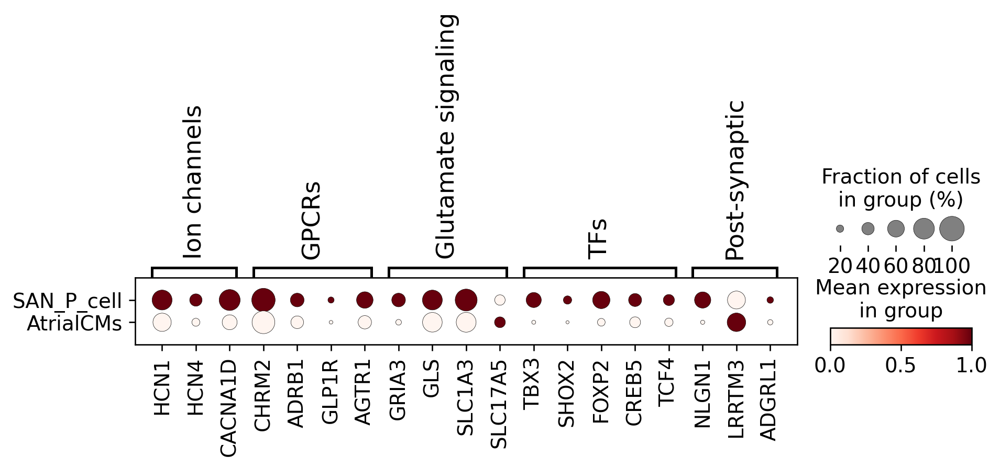

In [10]:
sc.settings.set_figure_params(dpi=120, color_map='RdPu')

markers={
    'Ion channels':['HCN1','HCN4','CACNA1D',], 
    # 'AV bundle cell':['GJA5','CRNDE','CNTN5'],
    'GPCRs':['CHRM2','ADRB1','GLP1R','AGTR1'],
    'Glutamate signaling':['GRIA3','GLS','SLC1A3','SLC17A5'],
    'TFs':['TBX3','SHOX2','FOXP2','CREB5','TCF4'],
    'Post-synaptic':['NLGN1','LRRTM3','ADGRL1']
}

# cell adhesion protein on the postsynaptic membrane
for k,v in markers.items():
    markers[k]=[x for x in v if x in adata.var_names]

sc.pl.dotplot(adata, 
              markers, 
              groupby='CCS_or_others',
              dendrogram=False,
             # use_raw=True,
              standard_scale="var",
              color_map="Reds",
             swap_axes=False,
             # title='Neurexin receptors'
             )

In [11]:
# number of the cells
sum(adata.obs['CCS_or_others']=='SAN_P_cell')

245

In [29]:
len(set(adata.obs['donor']))

7

In [42]:
adata.obs['donor'].unique()

['AH1', 'A61', 'AV10', 'AV14', 'AV3', 'AV13', 'AH2']
Categories (7, object): ['A61', 'AH1', 'AH2', 'AV3', 'AV10', 'AV13', 'AV14']

## Save

In [39]:
adata.write('/nfs/team205/heart/anndata_objects/8regions/CCS_annotations_full/SAN-aCM_lognorm_umap.h5ad')

In [4]:
adata = sc.read_h5ad('/nfs/team205/heart/anndata_objects/8regions/CCS_annotations_full/SAN-aCM_lognorm_umap.h5ad')
adata

AnnData object with n_obs × n_vars = 9857 × 26710
    obs: 'sangerID', 'combinedID', 'donor', 'donor_type', 'region', 'region_finest', 'age', 'gender', 'facility', 'cell_or_nuclei', 'modality', 'kit_10x', 'flushed', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'scrublet_score', 'scrublet_leiden', 'cluster_scrublet_score', 'doublet_pval', 'doublet_bh_pval', 'batch_key', 'leiden_scVI', 'cell_type', 'cell_state_HCAv1', 'cell_state_scNym', 'cell_state_scNym_confidence', 'cell_state', 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'n_counts', '_scvi_batch', '_scvi_labels', 'clus20', 'doublet_cls', 'original_or_new', 'batch', 'scANVI_predictions', 'CCS_or_others'
    var: 'gene_name_scRNA-0-original', 'gene_name_snRNA-1-original', 'gene_name_multiome-2-original', 'n_cells', 'gene_id'
    uns: 'CCS_or_others_colors', '_scvi_manager_uuid', '_scvi_uuid', 'cell_state_colors', 'leiden', 'leiden_scVI

In [40]:
# get index of CCS cells
P_index = adata.obs_names[adata.obs['CCS_or_others']=='SAN_P_cell']
P_index.to_series().to_csv('/nfs/team205/heart/anndata_objects/8regions/CCS_annotations_full/SAN-P_index.csv',index=False)

## Proportions

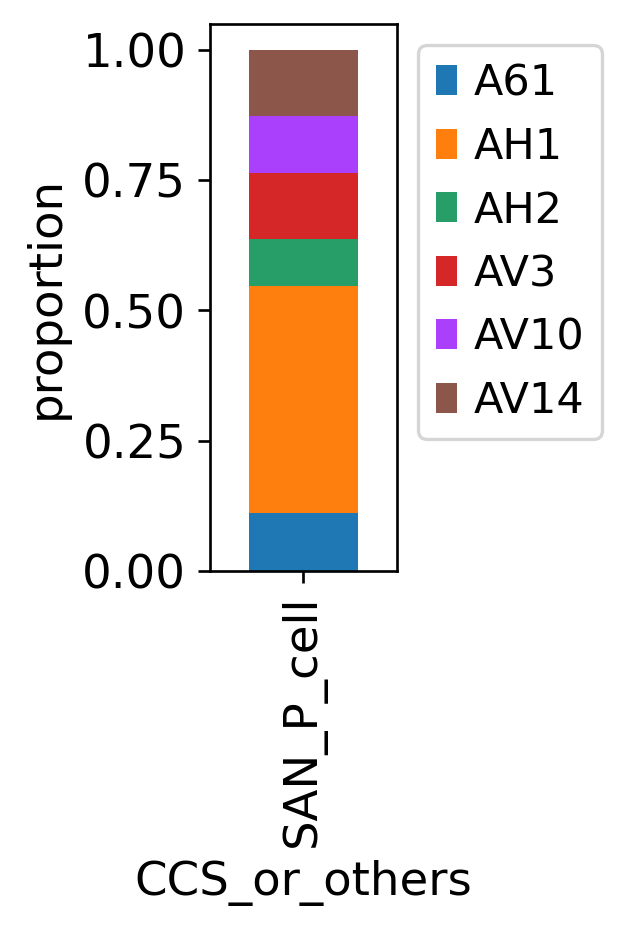

In [42]:
plt.rcParams['figure.figsize'] = 1,3
obs = adata.obs.copy()
obs = obs[obs['CCS_or_others']=='SAN_P_cell']

tmp = pd.crosstab(obs['CCS_or_others'], obs['donor'], normalize='index')
# tmp.plot.bar().legend(loc=1)
ax = tmp.plot.bar(stacked=True,width=0.7)
ax.grid(False)
ax.set_ylabel('proportion')
ax.legend(bbox_to_anchor=(1.0, 1.0))
ax.plot()
plt.show()

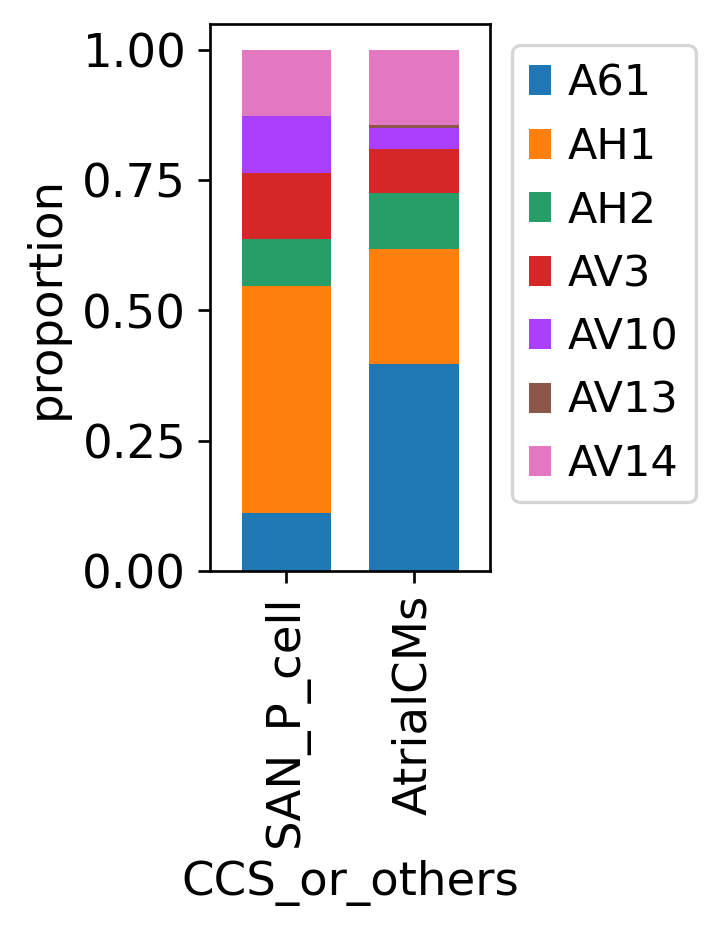

In [43]:
plt.rcParams['figure.figsize'] = 1.5,3
obs = adata.obs.copy()

tmp = pd.crosstab(obs['CCS_or_others'], obs['donor'], normalize='index')
# tmp.plot.bar().legend(loc=1)
ax = tmp.plot.bar(stacked=True,width=0.7)
ax.grid(False)
ax.set_ylabel('proportion')
ax.legend(bbox_to_anchor=(1.0, 1.0))
ax.plot()
plt.show()